# Car Crash Detection using Deep Learning

This project aims to develop a deep learning-based image classification model that can distinguish between car crash and non-crash images using convolutional neural networks (CNNs). The model is trained on a labeled dataset and evaluated using standard performance metrics. This notebook includes data preprocessing, model training, validation, and model saving for future inference.


## 1. Import Required Libraries

This section imports all necessary libraries, including PyTorch, torchvision, and utility modules for building and training the neural network.


In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import numpy as np
from torchvision import models, datasets
from torch.utils.data import DataLoader, random_split

## 2. Check for GPU Availability

Verify if CUDA-enabled GPU is available to accelerate model training. Displays the PyTorch version and device configuration.


In [2]:
print("Torch Version:", torch.__version__)
print("CUDA Available:", torch.cuda.is_available())
print("GPU Name:", torch.cuda.get_device_name(0) if torch.cuda.is_available() else "CPU Mode")

Torch Version: 2.6.0+cu124
CUDA Available: True
GPU Name: Tesla T4


## 3. Define Image Transformations

Set up preprocessing and data augmentation steps including resizing, normalization, random horizontal flips, and rotation. These transformations help improve model generalization.


In [3]:
transform = transforms.Compose([
    transforms.Resize((180, 180)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])

## 4. Load Dataset

Load the dataset from a local directory using `torchvision.datasets.ImageFolder`, applying the defined image transformations.


In [4]:
dataset = datasets.ImageFolder(root='/content/drive/MyDrive/crash detection/data/train', transform=transform)
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)

In [5]:
model = models.resnet50(pretrained=True)
num_ftrs = model.fc.in_features
model.fc = nn.Linear(num_ftrs, 2)
model = model.to(torch.device("cuda" if torch.cuda.is_available() else "cpu"))

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 121MB/s]


In [6]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

## 5. Train the Model with Model Saving and Cleanup

Train the model for a specified number of epochs. Save model checkpoints after each epoch and handle unexpected interruptions using a try-except block. Clear GPU memory after training to prevent kernel crashes.


In [7]:
# Loss Function and Optimizer
criterion = nn.CrossEntropyLoss(label_smoothing=0.1)
optimizer = optim.Adam(model.parameters(), lr=0.001)

# Training loop
epochs = 50
train_losses, val_losses = [], []
train_accuracies, val_accuracies = [], []

def accuracy(loader, model):
    correct = 0
    total = 0
    with torch.no_grad():
        for data in loader:
            images, labels = data
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    return 100 * correct / total

for epoch in range(epochs):
    model.train()
    running_loss = 0.0
    for images, labels in train_loader:
        images, labels = images.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = model(images)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()

    train_losses.append(running_loss / len(train_loader))
    train_accuracies.append(accuracy(train_loader, model))

    model.eval()
    val_loss = 0.0
    for images, labels in val_loader:
        images, labels = images.to(device), labels.to(device)
        outputs = model(images)
        loss = criterion(outputs, labels)
        val_loss += loss.item()

    val_losses.append(val_loss / len(val_loader))
    val_accuracies.append(accuracy(val_loader, model))

    print(f"Epoch {epoch+1}/{epochs}, Train Loss: {train_losses[-1]:.4f}, Train Acc: {train_accuracies[-1]:.2f}%, Val Loss: {val_losses[-1]:.4f}, Val Acc: {val_accuracies[-1]:.2f}%")

Epoch 1/50, Train Loss: 0.8197, Train Acc: 72.81%, Val Loss: 0.6450, Val Acc: 68.32%
Epoch 2/50, Train Loss: 0.6461, Train Acc: 74.38%, Val Loss: 0.6362, Val Acc: 65.22%
Epoch 3/50, Train Loss: 0.5990, Train Acc: 76.56%, Val Loss: 0.5288, Val Acc: 73.29%
Epoch 4/50, Train Loss: 0.5264, Train Acc: 80.62%, Val Loss: 0.5527, Val Acc: 77.64%
Epoch 5/50, Train Loss: 0.5131, Train Acc: 82.50%, Val Loss: 0.5154, Val Acc: 75.16%
Epoch 6/50, Train Loss: 0.4593, Train Acc: 83.12%, Val Loss: 0.5240, Val Acc: 76.40%
Epoch 7/50, Train Loss: 0.4589, Train Acc: 84.22%, Val Loss: 0.4401, Val Acc: 76.40%
Epoch 8/50, Train Loss: 0.4234, Train Acc: 85.47%, Val Loss: 0.4177, Val Acc: 78.88%
Epoch 9/50, Train Loss: 0.4326, Train Acc: 87.66%, Val Loss: 0.4352, Val Acc: 78.26%
Epoch 10/50, Train Loss: 0.4166, Train Acc: 85.94%, Val Loss: 0.4973, Val Acc: 80.75%
Epoch 11/50, Train Loss: 0.4163, Train Acc: 90.31%, Val Loss: 0.4379, Val Acc: 84.47%
Epoch 12/50, Train Loss: 0.3683, Train Acc: 90.94%, Val Loss: 0

## 10. Visualize Training and Validation Accuracy/Loss

Plot training and validation loss and accuracy curves to evaluate how well the model is learning over time.

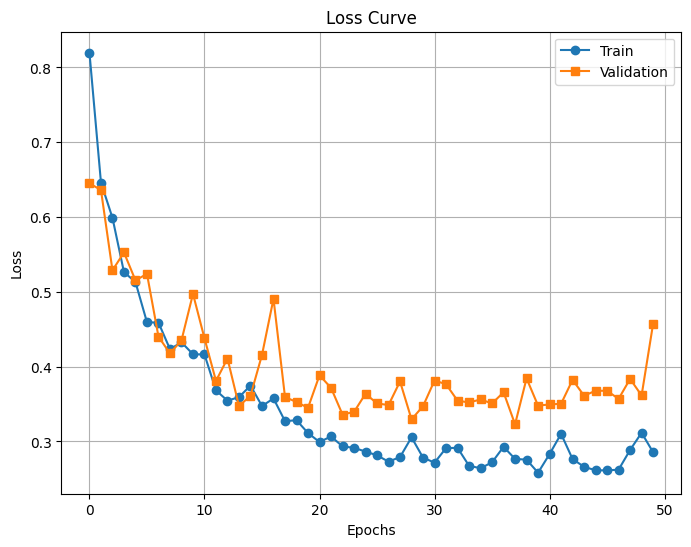

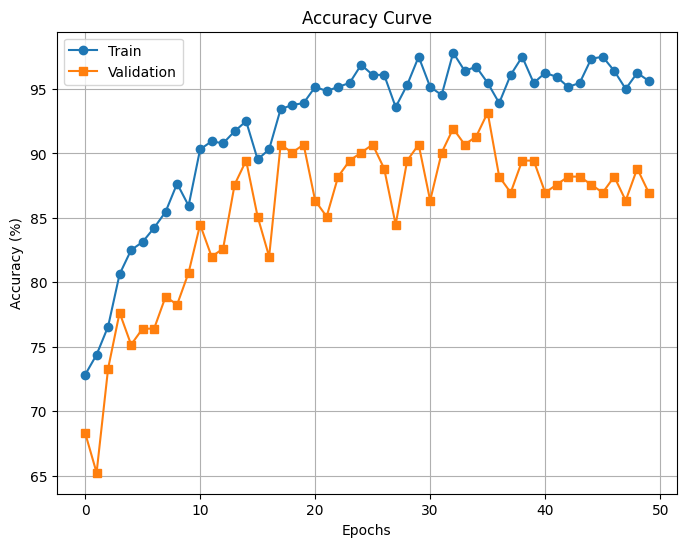

In [8]:
def plot_metrics(train_values, val_values, title, ylabel):
    plt.figure(figsize=(8, 6))
    plt.plot(train_values, label='Train', marker='o')
    plt.plot(val_values, label='Validation', marker='s')
    plt.title(title)
    plt.xlabel('Epochs')
    plt.ylabel(ylabel)
    plt.legend()
    plt.grid()
    plt.show()

plot_metrics(train_losses, val_losses, "Loss Curve", "Loss")
plot_metrics(train_accuracies, val_accuracies, "Accuracy Curve", "Accuracy (%)")

In [9]:
torch.save(model.state_dict(), "accident_detection_model.pth")
print("Model saved successfully!")

Model saved successfully!


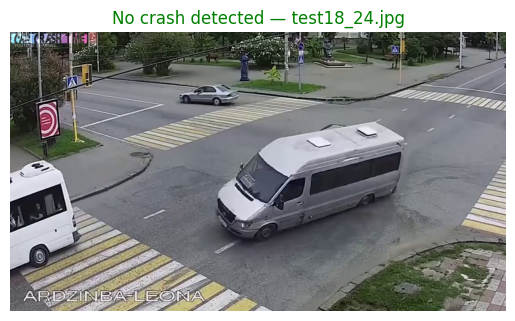

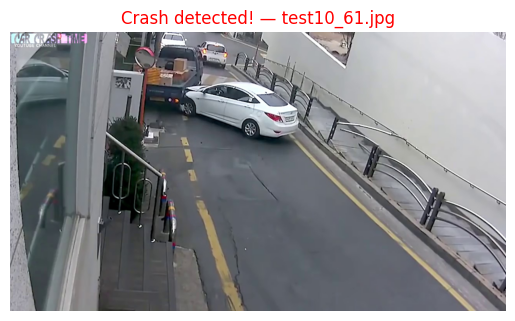

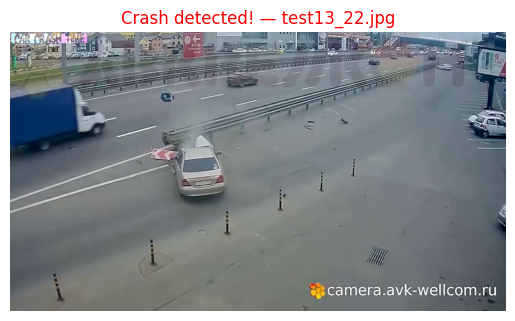

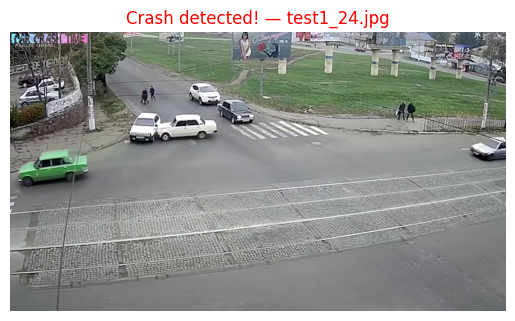

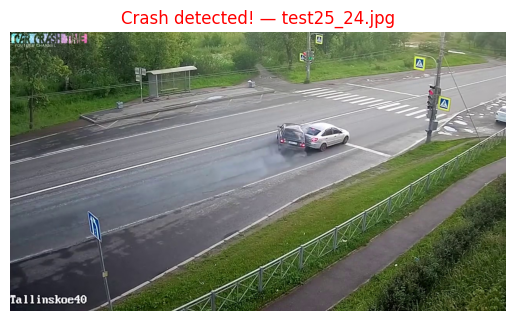

...

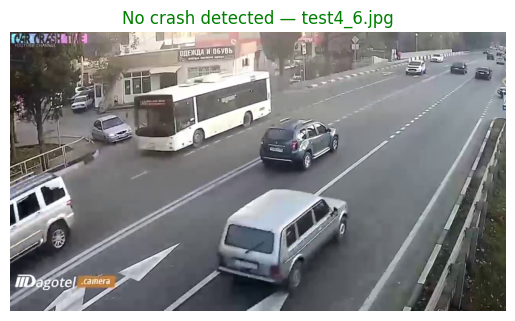

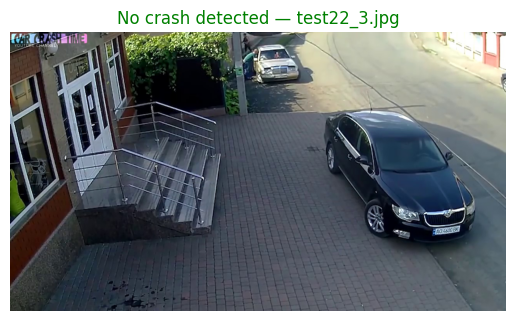

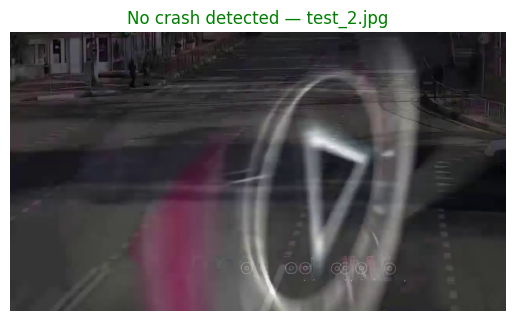

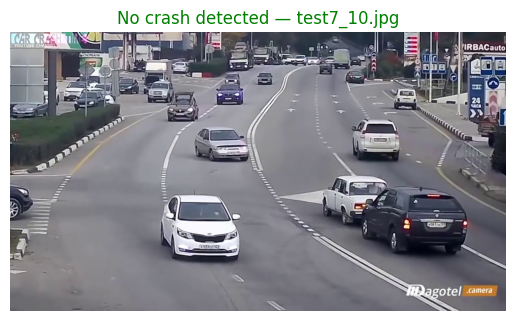

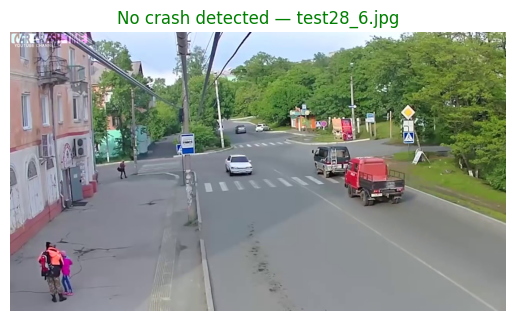

In [18]:
import os
import torch
import torchvision.transforms as transforms
from PIL import Image
import matplotlib.pyplot as plt
import torch.nn as nn
from torchvision.models import resnet50

testing_dir = "/content/drive/MyDrive/crash detection/data/test"
model_path = "/content/accident_detection_model.pth"
img_size = (180, 180)
class_names = ['Crash','No Crash']
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

transform = transforms.Compose([
    transforms.Resize(img_size),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5],
                         std=[0.5, 0.5, 0.5])
])

model = resnet50(weights=None)
model.fc = nn.Linear(model.fc.in_features, len(class_names))
model.load_state_dict(torch.load(model_path, map_location=device))
model.to(device)
model.eval()

def predict_image(image_path):
    image = Image.open(image_path).convert('RGB')
    img_tensor = transform(image).unsqueeze(0).to(device)

    with torch.no_grad():
        outputs = model(img_tensor)
        _, predicted = torch.max(outputs, 1)
        label = class_names[predicted.item()]

    return label, image

for filename in os.listdir(testing_dir):
    if filename.lower().endswith(('.jpg', '.jpeg', '.png')):
        path = os.path.join(testing_dir, filename)
        label, image = predict_image(path)

        plt.imshow(image)
        plt.axis('off')
        if label == "Crash":
            plt.title(f"Crash detected! — {filename}", color='red')
        else:
            plt.title(f"No crash detected — {filename}", color='green')
        plt.show()
